In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Load Data

In [2]:
data = pd.read_csv("data.csv")
data.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,26.822620,265.0,No,49.574949,21.46538,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.944960,266.0,No,49.574949,21.46538,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,28.609352,267.0,No,49.574949,21.46538,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.377862,268.0,No,49.574949,21.46538,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,24.797347,269.0,No,49.574949,21.46538,High_spent_Medium_value_payments,341.489231,Good


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  int64  
 1   Customer_ID               100000 non-null  int64  
 2   Month                     100000 non-null  int64  
 3   Name                      100000 non-null  object 
 4   Age                       100000 non-null  float64
 5   SSN                       100000 non-null  float64
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  float64
 8   Monthly_Inhand_Salary     100000 non-null  float64
 9   Num_Bank_Accounts         100000 non-null  float64
 10  Num_Credit_Card           100000 non-null  float64
 11  Interest_Rate             100000 non-null  float64
 12  Num_of_Loan               100000 non-null  float64
 13  Type_of_Loan              100000 non-null  ob

In [4]:
data.isnull().sum()

ID                          0
Customer_ID                 0
Month                       0
Name                        0
Age                         0
SSN                         0
Occupation                  0
Annual_Income               0
Monthly_Inhand_Salary       0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Type_of_Loan                0
Delay_from_due_date         0
Num_of_Delayed_Payment      0
Changed_Credit_Limit        0
Num_Credit_Inquiries        0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Credit_History_Age          0
Payment_of_Min_Amount       0
Total_EMI_per_month         0
Amount_invested_monthly     0
Payment_Behaviour           0
Monthly_Balance             0
Credit_Score                0
dtype: int64

### Label Column

In [5]:
data["Credit_Score"].value_counts()

Standard    53174
Poor        28998
Good        17828
Name: Credit_Score, dtype: int64

### Data Visualization

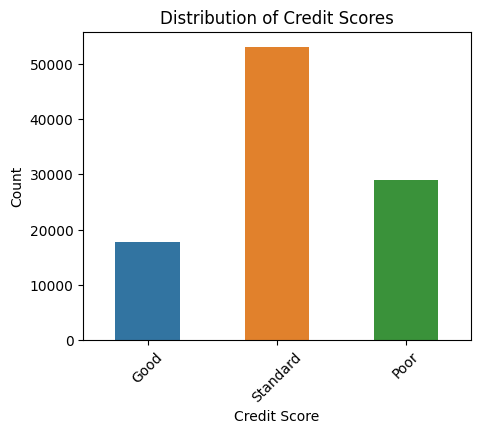

In [6]:
# Create a bar plot of the credit scores
plt.figure(figsize=(5, 4))
sns.countplot(data, x='Credit_Score', width=0.5)
plt.xlabel('Credit Score')
plt.ylabel('Count')
plt.title('Distribution of Credit Scores')
plt.xticks(rotation=45)
plt.show()


In [7]:
# Find the data types of all columns
data_types = data.dtypes

# Filter for object columns
object_columns = data_types[data_types == 'object']
column = object_columns.index.tolist()

# Print the object columns
print(column)

['Name', 'Occupation', 'Type_of_Loan', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour', 'Credit_Score']


In [8]:
for i in column:
    name = data[i].unique()
    w = {ni: indi for indi, ni in enumerate(set(name))}
    data[i] = data[i].apply(lambda x: w[x])

data.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,7468,23.0,821000265.0,9,19114.12,1824.843333,3.0,...,2,809.98,26.822620,265.0,1,49.574949,21.46538,4,312.494089,2
1,5635,3392,2,7468,23.0,821000265.0,9,19114.12,1824.843333,3.0,...,2,809.98,31.944960,266.0,1,49.574949,21.46538,5,284.629162,2
2,5636,3392,3,7468,23.0,821000265.0,9,19114.12,1824.843333,3.0,...,2,809.98,28.609352,267.0,1,49.574949,21.46538,2,331.209863,2
3,5637,3392,4,7468,23.0,821000265.0,9,19114.12,1824.843333,3.0,...,2,809.98,31.377862,268.0,1,49.574949,21.46538,1,223.451310,2
4,5638,3392,5,7468,23.0,821000265.0,9,19114.12,1824.843333,3.0,...,2,809.98,24.797347,269.0,1,49.574949,21.46538,3,341.489231,2


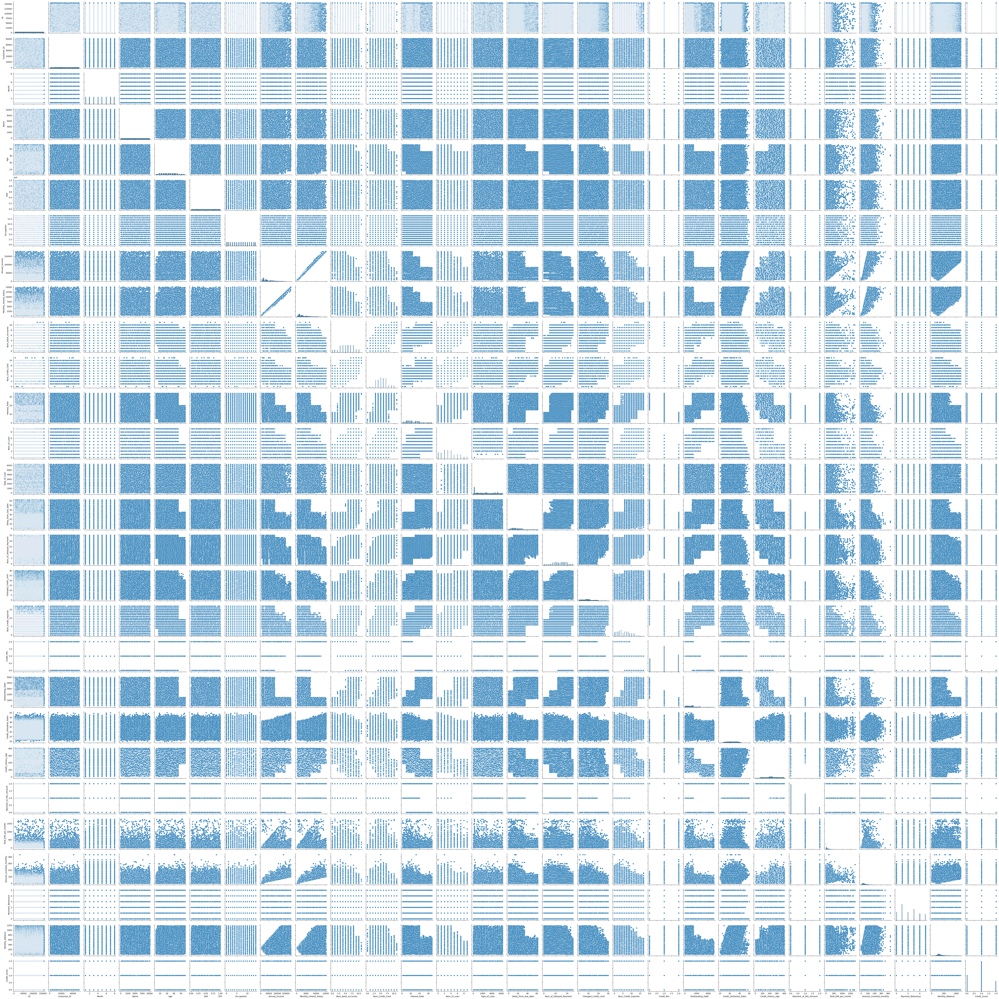

In [9]:
# Create a scatter plot matrix
sns.pairplot(data)
plt.show()

In [10]:
X = data.drop(['Credit_Score'], axis=1)
y = data['Credit_Score']

In [11]:
# Import train_test_split function
from sklearn.model_selection import train_test_split

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((80000, 27), (20000, 27), (80000,), (20000,))

In [12]:
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()
model.fit(X_train, y_train)
pred = model.predict(X_test)

# import classification_report
from sklearn.metrics import classification_report

# print classification report
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.82      0.87      0.85      5874
           1       0.86      0.83      0.85     10599
           2       0.81      0.81      0.81      3527

    accuracy                           0.84     20000
   macro avg       0.83      0.84      0.83     20000
weighted avg       0.84      0.84      0.84     20000

